In [63]:
print("SageMath:{}".format(version()))

SageMath:SageMath version 8.2, Release Date: 2018-05-05


In [64]:
print("Python version:{}".format(sys.version))

Python version:2.7.14 (default, May  6 2018, 17:10:16) 
[GCC 7.2.0]


# Ovals of Cassini
$(x^2+y^2)^2-2p^2(x^2-y^2)=a^4-p^4$

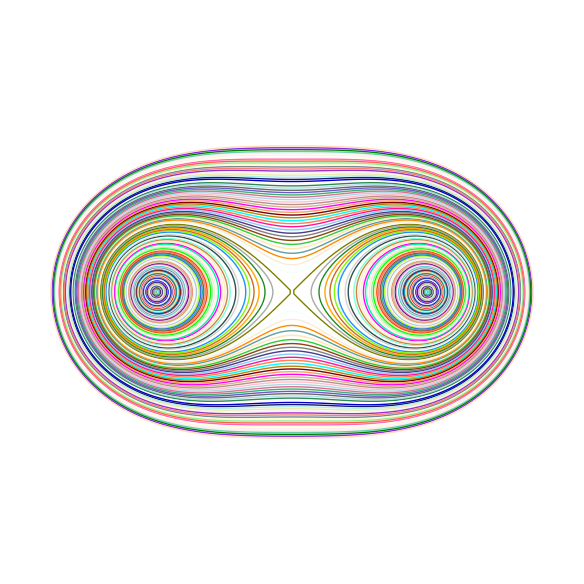

In [73]:
var("x y")
G = Graphics()
a=sqrt(1/2)
p=1
width=2
counter = 0
for col in colors.keys():
    G += implicit_plot((x^2+y^2)^2-2*p^2*(x^2-y^2)==(counter*.01)^4-p^4, (x,-width,width),(y,-width,width),color=col,frame=False,axes=False)
    counter += 1
G.show()
#G.save('cassini2.png',frame=False,axes=False)

In [1]:
def get_col_func(col_type, s=0.75, v=0.9):
    if col_type == 0:
        def col_func(param):
            return 'black'
    elif col_type == 1:
        def col_func(param):
            return hue(param,s=s,v=v)
    elif col_type == 2:
        def col_func(param):
            return hue(2/3 + 1/3 * param,s=s,v=v)
    elif col_type == 3:
        def col_func(param):
            return [param, 0, 1 - param]
    elif col_type == 4:
        col_keys = colors.keys()
        col_num = len(col_keys)
        def col_func(param):
            index = randint(0, col_num - 1)
            return col_keys[index]
    elif col_type == 5:
        col_keys = colors.keys()
        col_num = len(col_keys)
        def col_func(param):
            """Assumes param is a rational number"""
            index = numerator(param) % col_num
            return col_keys[index]        
    else:
        raise NotImplementedError
    return col_func

def get_value_range(increment, n_max, col_func):
    return [(increment * i, col_func(i/n_max)) for i in range(n_max)]

def draw_ovals(G, get_alg_eq, value_range, width):
    for a_val, col in value_range:
        alg_eq = get_alg_eq(a_val)
        G += implicit_plot(alg_eq, (x,-width,width),(y,-width,width),color=col)
    return G

In [56]:
increment_dict = {'dense':(0.025, 60), 'medium':(0.01, 148), 'very_sparse':(0.1, 15), 'sparse':(0.05, 30)}

/home/hisanobu_nakamura/SageMath/local/lib/python2.7/site-packages/matplotlib/contour.py:1180: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


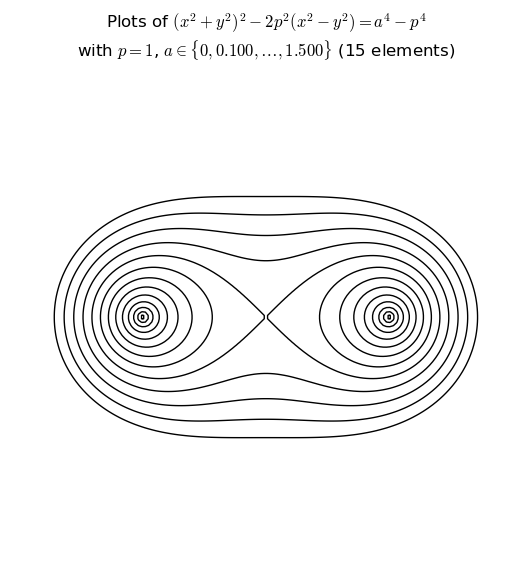

In [3]:
var("x y")
G = Graphics()
p = 1
width = 2

increment, n_max = increment_dict['very_sparse']
col_func = get_col_func(0)
value_range = get_value_range(increment, n_max, col_func)

def get_alg_eq(a_val):
    return (x^2 + y^2)^2 - 2*p^2*(x^2 - y^2) == (a_val)^4 - p^4

G = draw_ovals(G, get_alg_eq, value_range, width)
title = r"Plots of $(x^2+y^2)^2-2p^2(x^2-y^2)=a^4-p^4$" + "\n" \
+ "with $p={p}$, $a \in \{{ 0,{inc:.5}, \dots, {a_max:.5} \}}$ ({n_max} elements)".format(p=p, inc=increment, a_max=n_max * increment, n_max=n_max)
G.show(title=title,frame=False,axes=False)
#G.save('cassini2.png',frame=False,axes=False)

# Plots of zero curvature contours
The numerator of the curvature $K(x,y)$ of a curve determined by an implicit function equation $F(x,y) = a$ is given by
$$F_{xx} (F_{y})^2 + F_{yy} (F_{x})^2 - 2 F_{xy} F_{x} F_{y}$$
where $F_{x} := \frac{\partial F}{\partial x}$, etc.

In [4]:
def curvature_implicit(F):
    """returns numerator of curvature of F(x,y)=0"""
    F_x = diff(F,x)
    F_y = diff(F,y)
    F_xx = diff(F_x,x)
    F_xy = diff(F_x,y)
    F_yy = diff(F_y,y)
    return F_xx * (F_y)^2 + F_yy * (F_x)^2 - 2 * F_xy * F_x * F_y

In [30]:
def draw_ovals_legend(G, implicit_func, increment, width, inc_power=4):
    counter = 0
    for col in colors.keys():
        G += implicit_plot(implicit_func == (counter*increment)^inc_power, (x,-width,width),(y,-width,width),color=col)
        counter += 1
    return G

In [44]:
print(F)

(x, y) |--> -2*x^4 + 2*y^4 + (x^2 + y^2)^3 + x^2 + y^2


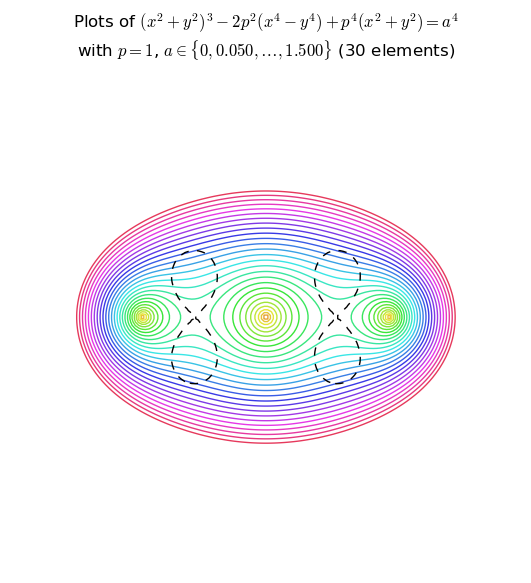

In [57]:
var("x y")
G = Graphics()
a=sqrt(1/2)
p=1
width=2
F(x,y) = (x^2+y^2)^3-2*p^2*(x^4-y^4) + p^4*(x^2+y^2)

increment, n_max = increment_dict['sparse']
col_func = get_col_func(1)
value_range = get_value_range(increment, n_max, col_func)

def get_alg_eq(a_val):
    return F == (a_val)^4

G = draw_ovals(G, get_alg_eq, value_range, width)
#G = draw_ovals_legend(G, F, 0.01, width)

#--- curvature of an implicit curve
K = curvature_implicit(F)

G += implicit_plot(K == 0,(x,-width,width),(y,-width,width),color = 'black',linestyle = "--")

title = r"Plots of $(x^2+y^2)^3-2p^2(x^4-y^4) + p^4(x^2+y^2)=a^4$" + "\n" \
+ "with $p={p}$, $a \in \{{ 0,{inc:.5}, \dots, {a_max:.5} \}}$ ({n_max} elements)".format(p=p, inc=increment, a_max=n_max * increment, n_max=n_max)
G.show(title=title, frame=False)

In [17]:
def norm_euc(v):
    """2-D Euclidean norm. Needs this for derivatives to work"""
    return sqrt(v[0]^2 + v[1]^2)

def get_cassinian_func(var_point, vertices, norm):
    return prod(map(lambda vertex: norm(var_point - vertex), vertices))

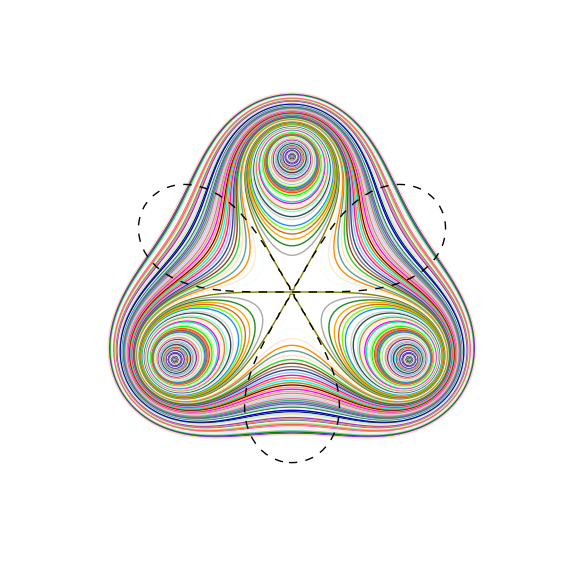

In [32]:
var("x,y")
vertices_raw = [[0,1], [sqrt(3)/2,-1/2], [-sqrt(3)/2,-1/2]]
vertices = list(map(vector, vertices_raw))
var_point = vector([x,y])
F = get_cassinian_func(var_point, vertices, norm_euc)
G = Graphics()
p = 1
width = 2

#--- curvature of an implicit curve
K = curvature_implicit(F^2)
G = draw_ovals_legend(G, F, 0.01, width, inc_power=2)

G += implicit_plot(K==0,(x,-width,width),(y,-width,width),color = 'black',linestyle = "--")
G.show(frame=False)
#G.save('cassini3_omusubi.png',frame=False,axes=False)

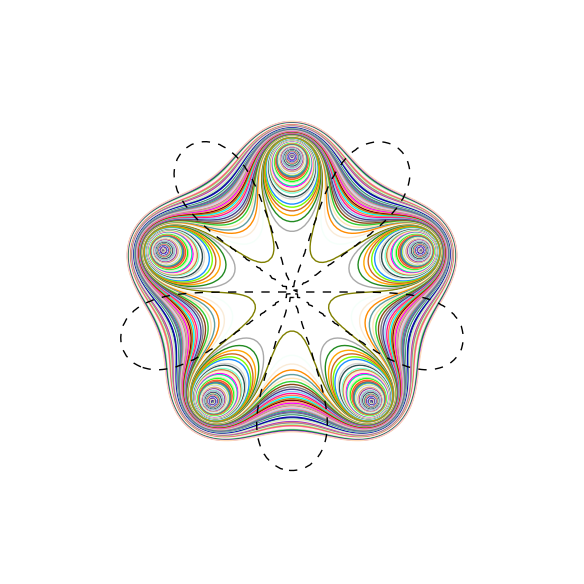

In [36]:
var("x,y")
vertices_raw = [[0,1], [-sin(2*pi/5),cos(2*pi/5)], [-sin(4*pi/5),cos(4*pi/5)], [sin(4*pi/5),cos(4*pi/5)], [sin(2*pi/5),cos(2*pi/5)]]
vertices = list(map(vector, vertices_raw))
var_point = vector([x,y])
F = get_cassinian_func(var_point, vertices, norm_euc)
G = Graphics()
p=1
width=2
G = draw_ovals_legend(G, F, 0.01001, width, inc_power=2)
#--- curvature of an implicit curve
K = curvature_implicit(F^2)
G += implicit_plot(K==0,(x,-width,width),(y,-width,width),color = 'black',linestyle = "--")
G.show(frame=False)

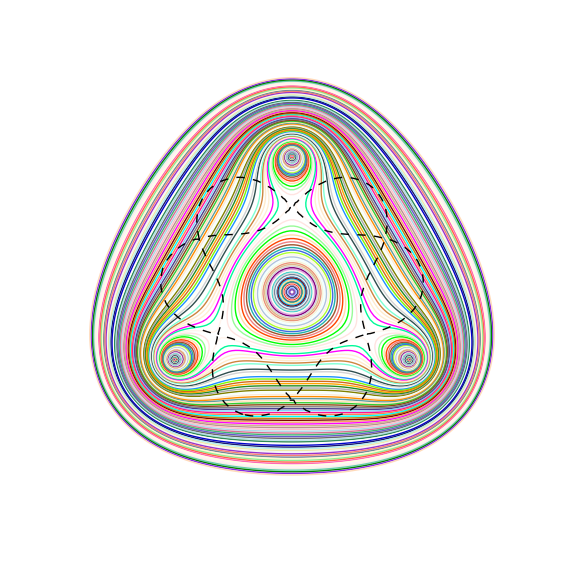

In [37]:
var("x,y")
vertices_raw = [[0,0], [0,1], [sqrt(3)/2,-1/2], [-sqrt(3)/2,-1/2]]
vertices = list(map(vector, vertices_raw))
var_point = vector([x,y])
F = get_cassinian_func(var_point, vertices, norm_euc)
G = Graphics()
p=1
width=2.
G = draw_ovals_legend(G, F, 0.01, width)
#--- curvature of an implicit curve
K = curvature_implicit(F^2)
G += implicit_plot(K==0,(x,-width,width),(y,-width,width),color = 'black',linestyle = "--")
G.show(frame=False)

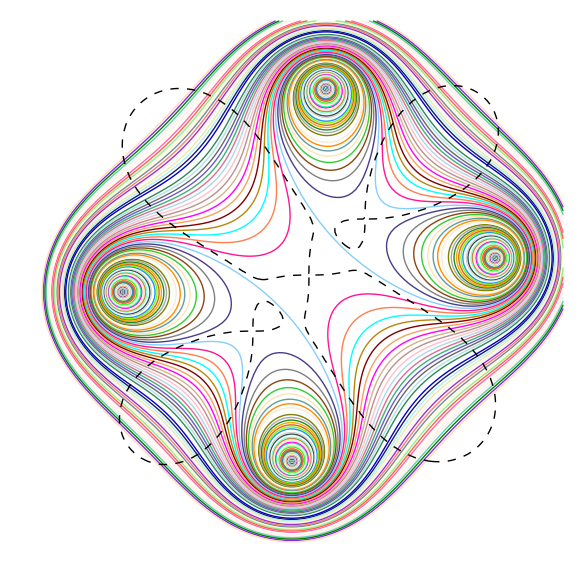

In [39]:
var("x,y")
vertices_raw = [[0.2,1.2], [-1,0], [0,-1], [1.2,0.2]]
vertices = list(map(vector, vertices_raw))
var_point = vector([x,y])
F = get_cassinian_func(var_point, vertices, norm_euc)
G = Graphics()
p=1
width=1.6
G = draw_ovals_legend(G, F, 0.01, width)
#--- curvature of an implicit curve
K = curvature_implicit(F^2)
G += implicit_plot(K==0,(x,-width,width),(y,-width,width),color = 'black',linestyle = "--")
G.show(frame=False)

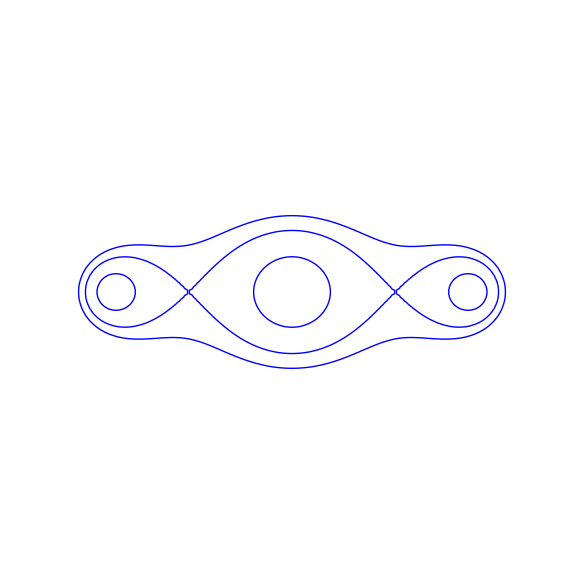

In [40]:
var("x y")
p=0.99
a=4*p^6/27
d = 0.1
width=1.5
G = implicit_plot((x^2+y^2)^3-2*p^2*(x^4-y^4) + p^4*(x^2+y^2)==a, (x,-width,width),(y,-width,width))
G1 = implicit_plot((x^2+y^2)^3-2*p^2*(x^4-y^4) + p^4*(x^2+y^2)==a+d, (x,-width,width),(y,-width,width))
G2 = implicit_plot((x^2+y^2)^3-2*p^2*(x^4-y^4) + p^4*(x^2+y^2)==a-d, (x,-width,width),(y,-width,width))
(G+G1+G2).show(frame=False)

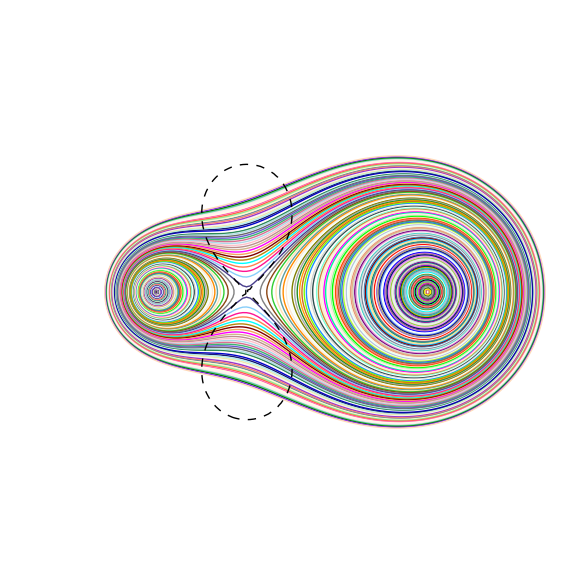

In [17]:
var("x,y")
v = vector([x,y])
v1 = vector([1,0])
v2 = vector([-1,0])

F = (norm_euc(v - v1)^2) * norm_euc(v - v2)
G = Graphics()
a=sqrt(1/2)
p=1
width=2

#--- curvature of an implicit curve
K = curvature_implicit(F^2)

counter = 0
for col in colors.keys():
    G += implicit_plot(F==(counter*.01)^2, (x,-width,width),(y,-width,width),color=col)
    counter += 1
G += implicit_plot(K==0,(x,-width,width),(y,-width,width),color = 'black',linestyle = "--")
G.show(frame=False)

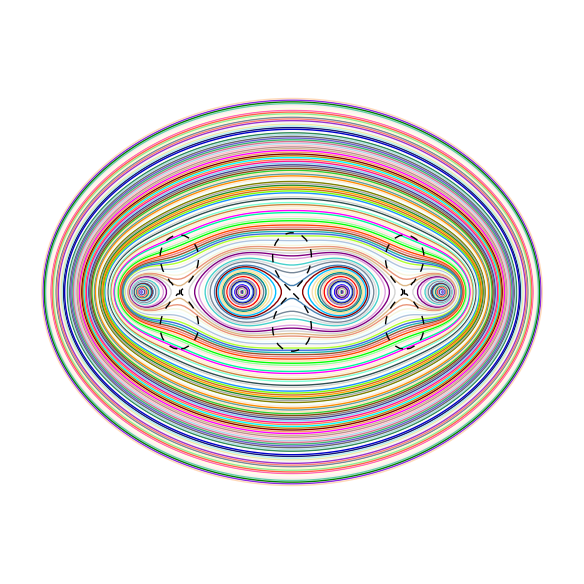

In [18]:
var("x,y")
v = vector([x,y])
v1 = vector([-1.,0])
v2 = vector([-1/3,0])
v3 = vector([1/3,0])
v4 = vector([1,0])
F = norm_euc(v - v4) * norm_euc(v - v1) * norm_euc(v - v2) * norm_euc(v - v3)
G = Graphics()
a=sqrt(1/2)
p=1
width=1.8

#--- curvature of an implicit curve
K = curvature_implicit(F^2)

counter = 0
for col in colors.keys():
    G += implicit_plot(F==(counter*.01)^4, (x,-width,width),(y,-width,width),color=col)
    counter += 1
G += implicit_plot(K==0,(x,-width,width),(y,-width,width),color = 'black',linestyle = "--")

G.show(frame=False)

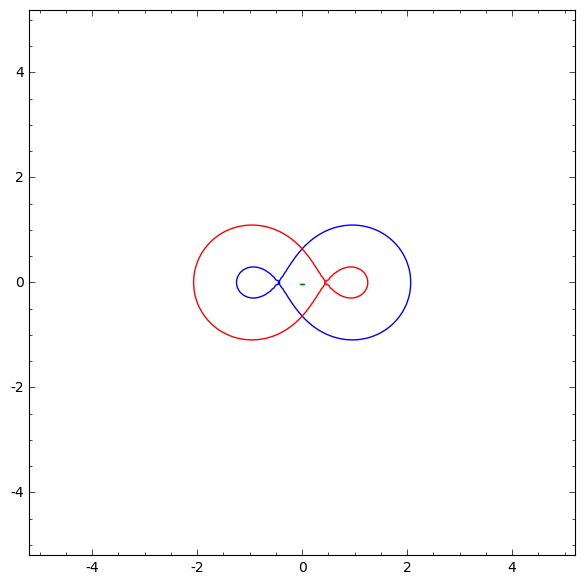

In [19]:
var("x y")
p=1
a=1.1075
d = 0.
width=5
v = vector([x,y])
v1 = vector([-p,0])
v2 = vector([p,0])
F1 = (norm(v2-v))^(norm(v1-v)) - a^2
F2 = (norm(v1-v))^(norm(v2-v)) - a^2
F3 = (norm(v1-v)+norm(v2-v))^(norm(v1-v)+norm(v2-v)) - a^2
G = implicit_plot(F1==0, (x,-width,width),(y,-width,width), color='blue')
G += implicit_plot(F2==0, (x,-width,width),(y,-width,width), color='red')
G += implicit_plot(F3==0, (x,-width,width),(y,-width,width), color='green')
G.show()

Animation with 32 frames
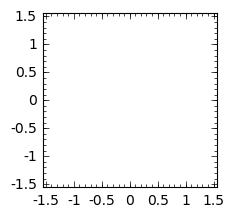

In [20]:
var("x y")
G = Graphics()
p=0.99
a=4*p^6/27
width=1.5
v = []
for i in srange(0,a+0.5,0.02):
    G = implicit_plot((x^2+y^2)^3-2*p^2*(x^4-y^4) + p^4*(x^2+y^2)==i^2, (x,-width,width),(y,-width,width))
    v.append(G)

a = animate(v, xmin=-width,ymin=-width,xmax=width,ymax=width,figsize=[2.5,2.5])
a.show() # optional -- ImageMagick

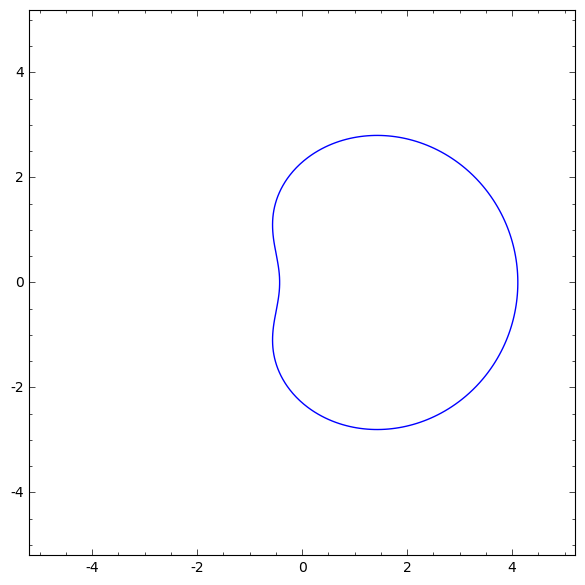

In [21]:
var("x y")
G= Graphics()
p=1
a=5
b = 0
width = 5
v = vector([x,y])
v1 = vector([-p,0])
v2 = vector([p,0])
r1 = norm(v-v1)
r2 = norm(v-v2)
F = r1 + r2 - a*r1/r2 -b
G = implicit_plot(F==0, (x,-width,width),(y,-width,width), color='blue')
G.show()

In [22]:
var("x,y,z")
G = Graphics()
#walls for ray-tracing
w = 1.6
wsize = w + .1
wcol = 'grey'
wall1 = implicit_plot3d(x==0,(x,0,wsize),(y,0,wsize),(z,0,wsize), color=wcol)
wall2 = implicit_plot3d(y==w,(x,0,wsize),(y,-wsize,wsize),(z,-wsize,wsize), color=wcol)
wall3 = implicit_plot3d(z==-w,(x,-wsize,wsize),(y,-wsize,wsize),(z,-wsize,wsize), color=wcol)
Walls = wall1 + wall2 + wall3
a=1.3
b=1
c=1
f1 = (y^2 + z^2 - a^2) 
f2 = (x^2 + z^2 - b^2)
f3 = (y^2 + x^2 - c^2)
g = x^2*y^2*z^2 
F = f1^2*x^2 + f2^2*y^2 + f3^2*z^2 - f1*f2*f3 - 4*g
P = x + y -c
bsize = w
tripolar = implicit_plot3d(F == 0, (x, 0, bsize), (y, 0,bsize), (z, 0,bsize), plot_points=100 ,opacity=.7)
plane1 = implicit_plot3d(P == 0, (x, 0, bsize), (y, 0,bsize), (z, 0,bsize), plot_points=100 ,opacity=.5,color='yellow')
G = tripolar + plane1 + Walls
G#.show(viewer='tachyon')

Graphics3d Object

In [18]:
var("x,y,z")
G = Graphics()
#walls for ray-tracing
w = 2
wsize = w + .1
wcol = 'grey'
wall1 = implicit_plot3d(x==-w,(x,-wsize,wsize),(y,-wsize,wsize),(z,-wsize,wsize), color=wcol)
wall2 = implicit_plot3d(y==w,(x,-wsize,wsize),(y,-wsize,wsize),(z,-wsize,wsize), color=wcol)
wall3 = implicit_plot3d(z==-w,(x,-wsize,wsize),(y,-wsize,wsize),(z,-wsize,wsize), color=wcol)
Walls = wall1 + wall2 + wall3
#--- x:y:z stands for tripolar coordinates ---#
# (a,b,c) is the length of the edges.
# and F(x,y,z) = 0 is the consistency condition.
a=1
b=1.1
c=1.2
f1 = (y^2 + z^2 - a^2) 
f2 = (x^2 + z^2 - b^2)
f3 = (y^2 + x^2 - c^2)
g = x^2*y^2*z^2 
bsize = w
F = f1^2*x^2 + f2^2*y^2 + f3^2*z^2 - f1*f2*f3 - 4*g
tripolar = implicit_plot3d(F == 0, (x, -bsize, bsize), (y, -bsize,bsize), (z, -bsize,bsize), plot_points=100 ,opacity=.6)
para = 0.02
cassini3 = implicit_plot3d(g == para, (x, -bsize, bsize), (y, -bsize,bsize), (z, -bsize,bsize), plot_points=100 ,opacity=.5,color = 'yellow')
G = tripolar + cassini3 + Walls
G #.show(viewer='tachyon')
#graphs = G.tachyon()
#tachyon_rt(graphs)

[
[x == 0, y == 0, z == 0],
[x == (49/25), y == (21/25), z == (21/25)],
[x == (169/225), y == (13/9), z == (13/9)],
[x == (91/75), y == -4/15*I*sqrt(3) + 1, z == 4/15*I*sqrt(3) + 1],
[x == (91/75), y == 4/15*I*sqrt(3) + 1, z == -4/15*I*sqrt(3) + 1]
]


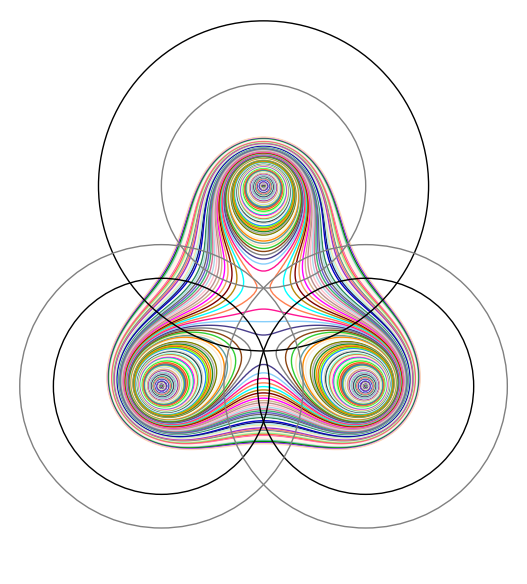

In [23]:
var("x,y,z")
def vect_conv(coord):
    triangle =[]
    for i in range(3):
        triangle.append( vector(coord[i]) )
    return triangle
coord = [[0,1.2],[sqrt(3)/2,-1/2],[-sqrt(3)/2,-1/2]]
v = vect_conv(coord)
L = [0,0,0]
L[0] = norm(v[1] -v[2])
L[1] = norm(v[2] -v[0])
L[2] = norm(v[0] -v[1])
f1 = 9*y*z == 2*(L[1]^2*y + L[2]^2*z) - L[0]^2*x
f2 = 9*z*x == 2*(L[0]^2*x + L[2]^2*z) - L[1]^2*y
f3 = 9*x*y == 2*(L[0]^2*x + L[1]^2*y) - L[2]^2*z
sol1 = solve([f1,f2,f3],x,y,z)
print sol1
def get_right(eq):
    return eq.right()
def get_positive(sol):
    column = len(sol)
    pos_roots = []
    num_sol = [0,0,0]
    for i in range(column):
        pos = 1
        for j in range(3):
            if get_right(sol[i][j]) <= 0:
                pos=0
            elif not imag(get_right(sol[i][j])) ==0 :
                pos = 0
        if pos == 1: # selecting those with all positive roots
            num_sol = [0,0,0]
            for k in range(3):
                num_sol[k] = get_right(sol[i][k])
            pos_roots.append(num_sol)
    return pos_roots
def sqrt_it(sol):
    column = len(sol)
    sqrt_roots = []
    for i in range(column):
        root = [0,0,0]
        for j in range(3):
            root[j] = sqrt(sol[i][j])
        sqrt_roots.append(root)
    return sqrt_roots
pos_sol = get_positive(sol1)
#--- getting the singular points in tripolar coordinates ---#
sing_points = sqrt_it(pos_sol)
c_col1 = 'black'
circles = circle(v[0],sing_points[0][0],color=c_col1)
circles += circle(v[1],sing_points[0][1],color=c_col1)
circles += circle(v[2],sing_points[0][2],color=c_col1)
c_col2 = 'grey'
if len(sing_points) ==2:
    circles += circle(v[0],sing_points[1][0],color=c_col2)
    circles += circle(v[1],sing_points[1][1],color=c_col2)
    circles += circle(v[2],sing_points[1][2],color=c_col2)


vec = vector([x,y])
F = norm(vec - v[0])*norm(vec - v[1])*norm(vec - v[2])
G = Graphics()
width=2
counter = 0
for col in colors.keys():
    G += implicit_plot(F==(counter*.01)^2, (x,-width,width),(y,-width,width),color=col)
    counter += 1
G += circles
G.show(frame=False)

In [20]:
var('x,y,z,e,f,g')
var('A,B,C')
assume(z>0,C>0)
e = A;f=B;g=C
def get_right(eq):
    return eq.right()

poly1 = 9*y*z == 2*(f*y + g*z) - e*x
poly2 = 9*x*z == 2*(e*x + g*z) - f*y
poly3 = 9*y*x == 2*(f*y + e*x) - g*z
sol_z = solve([poly1,poly2],x,y)
poly3.substitute(x=get_right(sol_z[0][0]),y=get_right(sol_z[0][1])).simplify_full()

-36*(3*A*z^3 - 9*z^4 - (A*z^2 - 3*z^3)*B)*C^2/(36*A^2*z^2 - 324*A*z^3 + 729*z^4 + (A^2 - 12*A*z + 36*z^2)*B^2 - 6*(2*A^2*z - 21*A*z^2 + 54*z^3)*B) == 9*(2*A*z^2 - 3*z^3 - (A*z - 2*z^2)*B)*C/((A - 6*z)*B - 6*A*z + 27*z^2)

In [21]:
var('x,y,z,e,f,g')
var('A,B,C')
h1 = expand(36*C*(B-3*z)*(A-3*z))
h2 = ((A*B -6*(A+B)*z + 27*z^2)^2).expand()
h3 = 8*A*B - 12*(A+B)*z
(h1+h2+h3).collect(z)

-324*(A + B)*z^3 + A^2*B^2 + 729*z^4 + 18*(2*A^2 + 7*A*B + 2*B^2 + 18*C)*z^2 + 36*A*B*C - 12*(A^2*B + A*B^2 + 9*A*C + 9*B*C + A + B)*z + 8*A*B

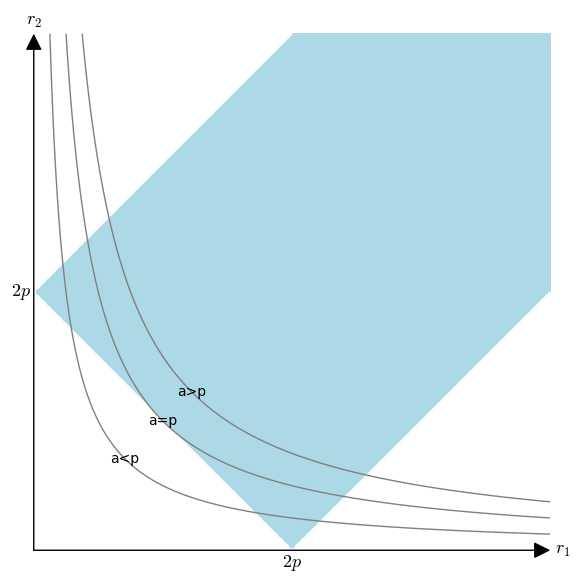

In [24]:
var('x,y')
# the reality region
p=1
def get_axes(xmin,xmax,ymin,ymax,ax_width,col,xlab,ylab,fsize):
    ax = Graphics() 
    ax += arrow((xmin,0),(xmax,0),color=col,width=ax_width)
    ax += text(xlab,(xmax+.1,0),color=col,fontsize=fsize)
    ax += arrow((0,ymin),(0,ymax),color=col,width=ax_width)
    ax += text(ylab,(0,ymax+.1),color=col,fontsize=fsize)
    return ax
axes = Graphics() 
axes = get_axes(0,4*p,0,4*p, 1, 'black','$r_1$','$r_2$',13)
reality = region_plot([x+y >= 2*p, x <= y + 2*p, y <= x + 2*p], (x,0,4*p),(y,0,4*p), incol = 'lightblue')
points = text('$2p$',(2*p,-.1),color='black',fontsize=13)
points += text('$2p$',(-.1,2*p),color='black',fontsize=13)
#cassinians
cassini = Graphics()
tcol='black' #colour of texts
for i in range(3):
    cassini += implicit_plot(x*y== 0.5 + i/2, (x,0,4*p),(y,0,4*p), color='grey')
    if i<1:
        cassini += text('a<p',(sqrt(0.5+i),sqrt(0.5+i)),color=tcol)
    elif i==1:
        cassini += text('a=p',(sqrt(0.5+i/2),sqrt(0.5+i/2)),color=tcol)
    else:
        cassini += text('a>p',(sqrt(0.5+i/2),sqrt(0.5+i/2)),color=tcol)
(reality + cassini + axes + points).show(frame = False)

In [23]:
imag(1+3*I)

3

In [24]:
len([[1,2],2,3])

3

In [25]:
var("x,y,z")
ver_n = 4
def vect_conv(coord):
    triangle =[]
    for i in range(ver_n):
        triangle.append( vector(coord[i]) )
    return triangle
edges_num = 1/2*ver_n*(ver_n-1)
k = 2*pi/ver_n
coord = []
for i in range(ver_n):
    coord.append([cos(k*i),sin(k*i)])
v = vect_conv(coord)
L = []
for i in range(ver_n):
    for j in range(i+1,ver_n):
        L.append(norm(v[i] -v[j])^2)
L
var('u0,u1,u2,u3,u4')
u = [u0,u1,u2,u3]
F = []
for i in range(ver_n):
    f=0
    for j in range(ver_n):
        f += (ver_n - 1)*norm(v[i] -v[j])^2*u[i]*u[j]
    for k in range(ver_n):
        for l in range(k+1,ver_n):
            if k != i and l != i :
                f += - norm(v[k] -v[l])^2*u[k]*u[l]
    f += -ver_n^2*u[i]
    F.append(f)
print F
sol1 = solve(F[0],u0)
sol2 = F[1].substitute(u0 = sol1[0].right())
sol3 = F[2].substitute(u0 = sol1[0].right())
sol4 = F[3].substitute(u0 = sol1[0].right())
sol5 = solve(sol2,u1)
sol6_1 = sol3.substitute(u1 = sol5[0].right())
sol7_1 = sol4.substitute(u1 = sol5[0].right())
sol8_1 = solve(sol6_1,sol7_1,u2,u3)
#print sol7_1
#sol9_1 = sol4.substitute(u2 = sol8_1[0].right())

[6*u0*u1 + 12*u0*u2 + 6*u0*u3 - 2*u1*u2 - 4*u1*u3 - 2*u2*u3 - 16*u0, 6*u0*u1 - 4*u0*u2 - 2*u0*u3 + 6*u1*u2 + 12*u1*u3 - 2*u2*u3 - 16*u1, -2*u0*u1 + 12*u0*u2 - 2*u0*u3 + 6*u1*u2 - 4*u1*u3 + 6*u2*u3 - 16*u2, -2*u0*u1 - 4*u0*u2 + 6*u0*u3 - 2*u1*u2 + 12*u1*u3 + 6*u2*u3 - 16*u3]

In [27]:
var("x,y,z")
ver_n = 4
def vect_conv(coord):
    triangle =[]
    for i in range(ver_n):
        triangle.append( vector(coord[i]) )
    return triangle
edges_num = 1/2*ver_n*(ver_n-1)
k = 2*pi/ver_n
coord = []
for i in range(ver_n):
    coord.append([cos(k*i),sin(k*i)])
v = vect_conv(coord)
L = []
for i in range(ver_n):
    for j in range(i+1,ver_n):
        L.append(norm(v[i] -v[j])^2)
L
var('u0,u1,u2,u3')
u = [u0,u1,u2,u3]
F = []
for i in range(ver_n):
    f=0
    for j in range(ver_n):
        f += (ver_n - 1)*u[i]*u[j]
    for k in range(ver_n):
        for l in range(k+1,ver_n):
            if k != i and l != i:
                f += - u[k]*u[l]
    F.append(f)
F

[3*u0^2 + 3*u0*u1 + 3*u0*u2 + 3*u0*u3 - u1*u2 - u1*u3 - u2*u3, 3*u0*u1 - u0*u2 - u0*u3 + 3*u1^2 + 3*u1*u2 + 3*u1*u3 - u2*u3, -u0*u1 + 3*u0*u2 - u0*u3 + 3*u1*u2 - u1*u3 + 3*u2^2 + 3*u2*u3, -u0*u1 - u0*u2 + 3*u0*u3 - u1*u2 + 3*u1*u3 + 3*u2*u3 + 3*u3^2]

In [28]:
var('x,y')
f1 = (x-1)^2 + y^2 - 2
f2 = (x+1)^2 + y^2 - 2
find_root([f1,f2],[-1,1],[-1,1])

Traceback (most recent call last):
  File "<stdin>", line 1, in <module>
  File "_sage_input_28.py", line 10, in <module>
    exec compile(u'open("___code___.py","w").write("# -*- coding: utf-8 -*-\\n" + _support_.preparse_worksheet_cell(base64.b64decode("dmFyKCd4LHknKQpmMSA9ICh4LTEpXjIgKyB5XjIgLSAyCmYyID0gKHgrMSleMiArIHleMiAtIDIKZmluZF9yb290KFtmMSxmMl0sWy0xLDFdLFstMSwxXSk="),globals())+"\\n"); execfile(os.path.abspath("___code___.py"))' + '\n', '', 'single')
  File "", line 1, in <module>
    
  File "/private/var/folders/zD/zDOBjMUZE3ak2t+llgdMy++++TI/-Tmp-/tmprNf_ej/___code___.py", line 6, in <module>
    exec compile(u'find_root([f1,f2],[-_sage_const_1 ,_sage_const_1 ],[-_sage_const_1 ,_sage_const_1 ])' + '\n', '', 'single')
  File "", line 1, in <module>
    
  File "/Applications/Sage-5.3-OSX-64bit-10.6.app/Contents/Resources/sage/local/lib/python2.7/site-packages/sage/numerical/optimize.py", line 79, in find_root
    a = float(a); b = float(b)
TypeError: float() argument must be

In [29]:
var("x,y,p,a")
G = Graphics()
a=sqrt(1/2)
width = 2.
p = 1.

F(x,y) = (x^2+y^2)^2 - 2*p^2*x^2 + 2*p^2*y^2 - a^4 + p^4
def curvature_implicit(F):
    F_x = diff(F,x)
    F_y = diff(F,y)
    F_xx = diff(F_x,x)
    F_xy = diff(F_x,y)
    F_yy = diff(F_y,y)
    return F_xx * (F_y)^2 + F_yy * (F_x)^2 - 2 * F_xy * F_x * F_y
#--- curvature of an implicit curve
K = curvature_implicit(F)

counter = 0
for col in colors.keys():
    G += implicit_plot((x^2+y^2)^2-2*p^2*(x^2-y^2)==(counter*.01)^4-p^4, (x,-width,width),(y,-width,width),color=col,frame=False,axes=False)
    counter += 1
G += implicit_plot(K==0,(x,-width,width),(y,-width,width),color = 'black',linestyle = "--")
G.show()
#G.save('cassini2.png',frame=False,axes=False)

In [30]:
a = 1
p = 1
F(x,y) = (x^2+y^2)^2 - 2*p^2*x^2 + 2*p^2*y^2 - a^4 + p^4
k = 1.
F_x = k*diff(F,x)
F_y = k*diff(F,y)

width = 2.0

plot_slope_field(F_y/F_x, (x,-width,width),(y,-width,width), color='grey')

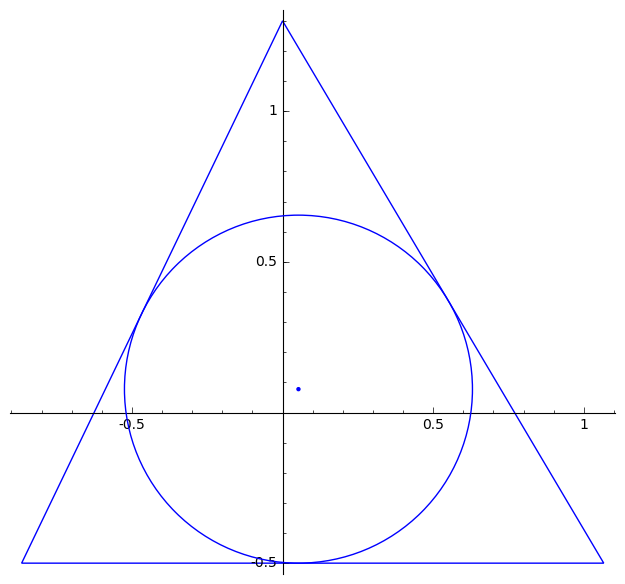

In [4]:
def vect_conv(coord):
    triangle =[]
    for i in range(3):
        triangle.append( vector(coord[i]) )
    return triangle
def get_edges(vertices):
    edges = []
    for i in range(3):
        if i < 2:
            e = vertices[i+1] - vertices[i]
            edges.append(e)
        else:
            e = vertices[0] - vertices[i]
            edges.append(e)
    return edges
def get_unitvec(vector):
    n = norm(vector)
    unitvec = 1/n * vector
    return unitvec
def normalise(edges):
    unitvecs = []
    for i in range(3):
        unitvecs.append(get_unitvec(edges[i]))
    return unitvecs
def get_length(edges):
    length = []
    for i in range(3):
        length.append(norm(edges[i]))
    return length
def get_inn_centre(coord):
    tri = vect_conv(coord) #convert the coordinates data to vectors
    edges = get_edges(tri) #get the edges of the triangle
    normals = normalise(edges) #normalise the length
    lengths = get_length(edges) #get the length of the triangle
    k = 1/2*(lengths[0] - lengths[1] + lengths[2])/(1 + normals[0]*(-1)*normals[2])
    inn_centre = tri[0] + k*(normals[0] + (-1)*normals[2])
    return inn_centre
def get_radius_inn(coord):
    tri = vect_conv(coord) #convert the coordinates data to vectors
    edges = get_edges(tri) #get the edges of the triangle
    normals = normalise(edges) #normalise the length
    lengths = get_length(edges) #get the length of the triangle
    x = (lengths[0] - lengths[1] + lengths[2])
    cot = sqrt((1 - normals[0]*(-1)*normals[2] )/(1 + normals[0]*(-1)*normals[2]))
    return 1/2*x*cot
    
coord = [[0,1.3],[sqrt(3)/2+.2,-1/2],[-sqrt(3)/2,-1/2]] #input coodrdinates of the vertices
triangle = polygon(coord, fill = False)
inn_centre = point(get_inn_centre(coord))
inn_radius = get_radius_inn(coord)
inn_circle = circle(get_inn_centre(coord), inn_radius)
triangle + inn_centre + inn_circle